# IBM Applied Data Capstone Project
# The Battle of the Neighbourhoods - Predicting the optimal location to open a Clothing Store in London, UK

## Introduction - Background
With over 8.5 million inhabitants, London is one of the largest and most influential cities in the world. Often regarded as one of the world's most connected cities, London has a diverse range of cultures with over 250 languages spoken in the region. Each year, the city attracts over 21 million international visitors as well as 28 million domestic tourists.
London is home to over 40,000 shops and 26 major street markets. Oxford Street is known as London’s busiest shopping street. Located in the heart of the city’s West End, Oxford Street offers a wide variety of clothing stores from high end luxury brands such as Louis Vuitton, Burberry and Gucci to high street fashion brands such as Zara, Tommy Hilfiger and Polo Ralph Lauren. 


There are many other types of clothing stores located in London to suit the different needs of customers, such as The North Face and Patagonia which sell mountain and winter clothing. There are also cheaper options for people looking to buy clothes on a budget, such as Primark and H&M. All in all, there is a clothing store for anyone and everyone. 

## Business Understanding
The goal of this project is to predict the optimal location to open a clothing store in London, UK. This report will provide stakeholders with an insight into which areas are the most promising based on a multitude of factors. The key stakeholder in this project are investors and owners looking to start or expand their clothing company into London. The reason why this project would be important to them is because they want to find the best area to open a store, and the analysis will allow them to make an informed decision backed by real data. Other stakeholders could be data enthusiasts and engineers looking to add more features to the model or perform the same analysis on another city such as Paris or New York.


Tackling the problem head on requires breaking down the end goal into objectives that are in support of the goal. By breaking down the objectives, structured discussions can take place where priorities can be identified in a way that can lead to organizing and planning how to tackle the problem at hand.


There are thousands of different clothing stores in London. The first objective is to locate all of these stores using the Foursquare API. We will also look at all shopping malls because this may have an impact on where the ideal location to open a store will be. The next step consists of using demographic data such as population density, average age and income to cluster similar areas in London. The optimal location to open a store will be in an area where there is a high concentration of clothing stores AND shopping malls. Ideally, this area should also have a high population density and average income.



## Analytics Approach
Selecting the right analytic approach is key to ensuring we answer the question being asked correctly and accurately. Given that we are trying to show relationships between different features within the model, we will use a descriptive model. We will use K-means clustering which is a simple and popular unsupervised machine learning algorithm to answer our question. A cluster is defined as a collection of data points that are aggregated together because of certain similarities. This will be the best technique to use for our use case.


We will use several data science tools to achieve the end goal. First, we must collect the required datasets, clean them and then merge them into one big dataset to prepare for the modelling stage. We will then use machine learning and visualization tools to generate the most promising areas based upon criteria we defined earlier.


Additionally, we will evaluate the quality of the model by through a diagnostic measures phase and statistical significance testing. These evaluation techniques ensure the model is working as intended and that the data is being properly handed and interpreted. Lastly, we will present our findings to the stakeholders so they can make an informed decision on where they would like to open their clothing store.

# Data Sources
We need to identify what datasets are needed, how to source or collect them, how to understand or work with them and how to prepare the data to meet the desired outcome. Based upon the criteria we defined earlier, there are several factors that will impact the final decision of which area to open a clothing store. These are:
* The number of clothing stores within the neighbourhood.
* The number of shopping malls within the neighbourhood.
* London census information – population, density, average age, average income.

We will define each neighbourhood using a grid format around the whole city. This grid will consist of many hexagons in a honeycomb layout. This will be the basis for defining different boroughs and neighbourhoods.
We will collect the data from the following sources:
* London borough boundaries shapefile which is defined using longitude and latitude values. Will be in geojson format to be easily integrated into analysis. Can be obtained from the London Datastore (publicly available).
* Coordinates which define the centre of London, this will be obtained using the Google Geocoding API.
* Clothing stores and shopping mall data in every borough will be obtained using Foursquare API.
* The centre of every borough will be defined using hexagon cells in a honeycomb layout, these will be calculated algorithmically. The addresses for those centres will be fetched by using the Google Geocoding API.
* London census data for the year 2016 will be obtained from the London Datastore (publicly available).

# Data Preparation
Before we make use of the Foursquare API and census data for London, we need to implement a process to uniquely identify each neighbourhood on the map. For this job we will use a honeycomb hexagon grid which will span across the whole London map. This grid format is a popular choice when performing any geospatial analysis.

The reason we are using hexagons instead of circles is because there is no spacing amongst hexagons when they are joined together in a grid. Each cell on the grid represents a candidate neighbourhood. 
The length of each side is 1000/√3 meters, and covers an area of approximately 0.87 square kilometres. As we are only performing an analysis on London, we will only use the honeycomb grid on areas within London.

Before we instantiate any honeycomb hexagon grid, we need to define the coordinates of central London as a starting point for our exploration. We will find the latitude and longitude of central London using the Google Geocoding API. 
The API provides geocoding and reverse geocoding of addresses. Geocoding is the process of converting addresses into latitude and longitude coordinates, we can use these coordinates to place markers on the map or explore specific areas. 

Below we can see the output of geocoding and reverse geocoding the center of London. We perform reverse geocoding to make sure everything is working as it should.

In [1]:
#import libraries required for data preparation
import requests
import geocoder
import json
import time
import urllib.error
import urllib.parse
import urllib.request
import numpy as np

In [2]:
google_api_key = 'x' #key removed for public sharing

In [3]:
# Define method to obtain the latitude and longitude of london center

def get_coordinates(address, api_key=google_api_key, verbose=False):
    try:
        url = 'https://maps.googleapis.com/maps/api/geocode/json?key={}&address={}'.format(api_key, address)
        response = requests.get(url)
        if verbose:
            print('Google Maps API JSON result =>', response.content)
        results = response.json()['results']
        geographical_data = results[0]['geometry']['location'] # get geographical coordinates
        lat = geographical_data['lat']
        lon = geographical_data['lng']
        return [lat, lon]
    except:
        return [None, None]
    
address = 'Trafalgar Square, Charing Cross, London, England'
london_center = get_coordinates(address)
print('Coordinate of {}: {}'.format(address, london_center))

Coordinate of Trafalgar Square, Charing Cross, London, England: [51.508039, -0.128069]


In [4]:
# Conversely, define a method to get address information given latitude and longtitude
def get_address(latitude, longitude, api_key=google_api_key, verbose=False):
    try:
        url = 'https://maps.googleapis.com/maps/api/geocode/json?key={}&latlng={},{}'.format(api_key, latitude, longitude)
        response = requests.get(url).json()
        if verbose:
            print('Google Maps API JSON result =>', response)
        results = response['results']
        address = results[0]['formatted_address']
        return address
    except:
        return None

addr = get_address(*london_center)
print('Reverse geocoding check')
print('-----------------------')
print('Address of [{}, {}] is: {}'.format(*london_center, addr))

Reverse geocoding check
-----------------------
Address of [51.508039, -0.128069] is: 5 Trafalgar Square, Charing Cross, London WC2N 5NJ, UK


Ok, we have now obtained the latitude and longitude information for the center of London. We have also done a reserve geocoding check (providing coordinates and receiving location) to make sure everything is working as it should.

In [5]:
# Suppress warnings

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

We will now create a method that loads a json file into a python dictionary. Later on we will call this method and pass the London boundary file in geojson format.

In [6]:
def load_dict(fileobject):
    '''Load the file contents into a Python dict'''
    text = fileobject.read()
    dictformat = json.loads(text)
    return dictformat

In [7]:
import os
import json
from shapely.geometry import shape, Point, Polygon

def read_geojson(filepath):
    with open(filepath, 'r') as f:
        js = json.load(f)
    return js

# get boundary from a geojson file
# output format: (minx, miny, maxx, maxy) tuple (float values) 
def get_boundary_from_geojson(geojson):
    js = read_geojson(geojson) if isinstance(geojson, str) else geojson
    polygon = [shape(feature['geometry']).bounds for feature in js['features']]

    boundary = []
    for p in polygon:
        boundary.append((p[0], p[1]))
        boundary.append((p[2], p[3]))
    return Polygon(boundary).bounds

# Given a point, check whether it's within the boundaries defined by GeoJSON file
# input: point = (longtitude, latitude)
# output: True if in polygon of geojson file
def is_in_geojson(geojson, point, verbose=False):    
    js = read_geojson(geojson) if isinstance(geojson, str) else geojson
    pos = point if isinstance(point, Point) else Point(point)

    for feature in js['features']:
        polygon = shape(feature['geometry'])
        if polygon.contains(pos):
            if verbose: print('Found in borough: ', feature['properties'])
            return True
    return False

# load GeoJSON file containing london boroughs
with open('x') as f:
  geoJson = json.load(f)

# get the boundaries of london island
london_boundary = get_boundary_from_geojson(geoJson)
print(f'The boundaries of London: {london_boundary}\n')

# check whether london center is in london
point = Point((london_center[1], london_center[0]))
print(f'London center ({point.x}, {point.y}) in geojson file: {is_in_geojson(geoJson, point, True)}')

The boundaries of London: (-0.510375069478728, 51.2867601558474, 0.33401556346767, 51.691874109516)

Found in borough:  {'id': 25, 'name': 'Westminster', 'code': 'E09000033', 'area_hectares': 2203.005, 'inner_statistical': True}
London center (-0.128069, 51.508039) in geojson file: True


In [8]:
#!pip install shapely
import shapely.geometry

import pyproj

import math

def lonlat_to_xy(lon, lat):
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    xy = pyproj.transform(proj_latlon, proj_xy, lon, lat)
    return xy[0], xy[1]

def xy_to_lonlat(x, y):
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    lonlat = pyproj.transform(proj_xy, proj_latlon, x, y)
    return lonlat[0], lonlat[1]

def calc_xy_distance(x1, y1, x2, y2):
    dx = x2 - x1
    dy = y2 - y1
    return math.sqrt(dx*dx + dy*dy)

def calc_lonlat_distance(lon1, lat1, lon2, lat2):
    x1, y1 = lonlat_to_xy(lon1, lat1)
    x2, y2 = lonlat_to_xy(lon2, lat2)
    return calc_xy_distance(x1, y1, x2, y2)

print('Coordinate transformation check')
print('-------------------------------')
print('London center longitude={}, latitude={}'.format(london_center[1], london_center[0]))
x, y = lonlat_to_xy(london_center[1], london_center[0])
print('London center UTM X={}, Y={}'.format(x, y))
lo, la = xy_to_lonlat(x, y)
print('London center longitude={}, latitude={}'.format(lo, la))
distance = calc_lonlat_distance(*london_boundary)
print(f'Distance from most southwest point to most northeast point in london is {distance} meters.')
ldn_min_x, ldn_min_y = lonlat_to_xy(london_boundary[0], london_boundary[1])
ldn_max_x, ldn_max_y = lonlat_to_xy(london_boundary[2], london_boundary[3])
print(f'Distance from west to east in london is {ldn_max_x-ldn_min_x} meters.')
print(f'Distance from north to south in london is {ldn_max_y-ldn_min_y} meters.')

Coordinate transformation check
-------------------------------
London center longitude=-0.128069, latitude=51.508039
London center UTM X=-547024.7470038583, Y=5815642.091429639
London center longitude=-0.12806899999999324, latitude=51.50803899999998
Distance from most southwest point to most northeast point in london is 74930.53671938865 meters.
Distance from west to east in london is 67558.25039984938 meters.
Distance from north to south in london is 32410.926181874238 meters.


We will now generate every possible candidate area within london.

In [9]:
ldn_center_x, ldn_center_y = lonlat_to_xy(london_center[1], london_center[0]) # City center in Cartesian coordinates
london_boroughs = geoJson 

k = math.sqrt(3) / 2 # Vertical distance coefficient for hexagon grid cells
x_step = 1000        # Distance between adjacent hexagons in the row
y_step = x_step * k  # Distance between adjacent hexagons in vertical direction

latitudes = []
longitudes = []
distances_from_central = []
xs = []
ys = []
num_columns = int((ldn_max_x - ldn_min_x)/x_step) + 1
num_rows = int((ldn_max_y - ldn_min_y)/y_step) + 1
for i in range(0, num_rows):
    y = ldn_min_y + i * y_step
    x_offset = x_step/2 if i%2==0 else 0
    for j in range(0, num_columns):
        x = ldn_min_x + j * x_step + x_offset
        lon, lat = xy_to_lonlat(x, y)
        if is_in_geojson(london_boroughs, (lon, lat)):
            distance = calc_xy_distance(ldn_center_x, ldn_center_y, x, y)
            latitudes.append(lat)
            longitudes.append(lon)
            distances_from_central.append(distance)
            xs.append(x)
            ys.append(y)

print(len(latitudes), 'candidate neighborhood centers are generated.')

1596 candidate neighborhood centers are generated.


Now we will generate hexagon cells for every candidate area we defined before.

In [10]:
import numpy as np
import math

def get_hexagon_coordinates(centroid_latlon, side_length_in_meters, rotate=False):
    # Rotate 90 degree
    unit_hexagon_vertices_rotate = np.array([[0, 1], [-math.sqrt(3)/2, 1/2], [-math.sqrt(3)/2, -1/2],
                                       [0, -1], [math.sqrt(3)/2, -1/2], [math.sqrt(3)/2, 1/2]])
    # Regular hexagon
    unit_hexagon_vertices = np.array([[1, 0], [1/2, math.sqrt(3)/2], [-1/2, math.sqrt(3)/2],
                                       [-1, 0], [-1/2, -math.sqrt(3)/2], [1/2, -math.sqrt(3)/2]])
    x, y = lonlat_to_xy(centroid_latlon[1], centroid_latlon[0])
    vertices = unit_hexagon_vertices_rotate if rotate else unit_hexagon_vertices
    vertices *= side_length_in_meters
    vertices = [xy_to_lonlat(v[0]+x, v[1]+y) for v in vertices]
    return vertices     # list of 6 (longitude, latitude) tuples

a = x_step/math.sqrt(3)
hexagons = []
for latlon in zip(latitudes, longitudes):
    vertices = get_hexagon_coordinates(latlon, a, True)
    hexagons.append(Polygon(vertices))

print(len(hexagons), 'candidate hexagon neighborhoods generated.')

1596 candidate hexagon neighborhoods generated.


In [11]:
#import folium - map library
import folium
from folium.features import DivIcon

def hexagon_style(feature):
    return { 'color': 'blue', 'fill': False }
def boroughs_style(feature):
    return { 'color': 'gray' }

We will now generate a map of london, where the boundaries of each borough are defined in grey, and the hexagon cells of each area in blue.

In [12]:
center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.Marker(london_center, popup='Central London').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
for i, hexagon in enumerate(hexagons):
    folium.GeoJson(hexagon.convex_hull, style_function=hexagon_style).add_to(map_london)
map_london

In [13]:
# Define a method to fetch all address given latitudes and longitudes list
def get_all_addresses(latitudes, longitudes):
    print('Obtaining location addresses: ', end='')
    addresses = []
    for lat, lon in zip(latitudes, longitudes):
        address = get_address(lat, lon)
        if address is None:
            address = 'NO ADDRESS'
        address = address.replace(', UK', '') # We don't need country part of address
        addresses.append(address)
        print(' .', end='')
    print(' done.')
    return addresses

In [14]:
import pandas as pd

#Fetch data from Foursquare API
addresses = get_all_addresses(latitudes, longitudes)
df_locations = pd.DataFrame({'Address': addresses,
                             'Latitude': latitudes,
                             'Longitude': longitudes,
                             'X': xs,
                             'Y': ys,
                             'Distance from central': distances_from_central})


# Save dataframe into local file
df_locations.to_pickle('./locations.pkl')

Obtaining location addresses:  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .

In [15]:
df_locations.head(10)

,Address,Latitude,Longitude,X,Y,Distance from central
0,"Rose Cottage, Carshalton Rd, Banstead SM7 3JA",51.332255,-0.171414,-554116.768333,5.796889e+06,20048.954645
1,"73 Lower Pillory Down, Little Woodcote, Little...",51.334091,-0.157560,-553116.768333,5.796889e+06,19717.417166
2,"6 Verulam Ave, Purley CR8 3NQ",51.335926,-0.143705,-552116.768333,5.796889e+06,19431.739424
3,"2 Silver Ln, Purley CR8 3HG",51.337760,-0.129848,-551116.768333,5.796889e+06,19193.969219
4,"926 Brighton Rd, Purley CR8 2LN",51.339592,-0.115990,-550116.768333,5.796889e+06,19005.904655
5,"5 Lexington Ct, Purley CR8 1JA",51.341422,-0.102130,-549116.768333,5.796889e+06,18869.032012
6,"Old Court, Hook Hill, South Croydon CR2 0LA",51.343251,-0.088269,-548116.768333,5.796889e+06,18784.470352
7,"149 Ridge Langley, South Croydon CR2 0AQ",51.345078,-0.074406,-547116.768333,5.796889e+06,18752.927339
8,"47 Foxearth Rd, South Croydon CR2 8EL",51.346903,-0.060542,-546116.768333,5.796889e+06,18774.670200
9,"33 Heathfield Vale, South Croydon CR2 8AG",51.348727,-0.046676,-545116.768333,5.796889e+06,18849.514541


# Foursquare API

Now that all of the candidate neighbourhoods have been generated, we will retrieve specific venue information using the Foursquare API.
_______________________________________________

The foursquare API documentation provides guidance on identifying **clothing shops** within london. This information is found in the **Shops** Venue category.
The ID corresponding to Clothing Stores is: **4bf58dd8d48988d103951735**


Below are sub-categories for **Clothing Stores** with corresponding ID's, which may be useful for further segmentation and analysis.
* Accessories Store: 4bf58dd8d48988d102951735
* Boutique: 4bf58dd8d48988d104951735
* Kids Store: 4bf58dd8d48988d105951735
* Lingerie Store: 4bf58dd8d48988d109951735
* Men's Store: 4bf58dd8d48988d106951735
* Shoe Store: 4bf58dd8d48988d107951735
* Women's Store: 4bf58dd8d48988d108951735
________________________________________________

Let's have a look at all the Clothing stores in London, and visualise them on a map.

In [16]:
# Get center coordinates of each borough and municipality

def get_borough_center(borough_geojson):
    center = []
    for feature in borough_geojson['features']:
        polygon = shape(feature['geometry'])
        center.append((polygon.centroid.x, polygon.centroid.y))
    return center

london_borough_centers = get_borough_center(london_boroughs)
print(f'{len(london_borough_centers)} center coordinates are generated.')

33 center coordinates are generated.


Let's define our Foursquare Credentials in order retrieve venue information from the API.

In [17]:
client_id = 'x'
client_secret = 'x'

In [18]:
from datetime import date

shop_categories = ['4bf58dd8d48988d103951735',]  #Clothing store

def is_shop(categories, shop_filter=shop_categories):
    for c in categories:
        category_id = c[1]
        if category_id in shop_filter:
            return True
    return False

def get_categories(categories):
    return [(cat['name'], cat['id']) for cat in categories]

def format_address(location):
    return location['formattedAddress'][0]

# Searching for movie theaters based on latitude and longitude
def get_shops_near_location(lat, lon, category, client_id, client_secret, radius=600, limit=50):
    version = date.today().strftime("%Y%m%d")
    categories = category if isinstance(category, str) else ','.join(category)
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(client_id, client_secret, version, lat, lon, categories, radius, limit)
    try:
        results = requests.get(url).json()['response']['venues']
        venues = [(item['id'],
                   item['name'],
                   get_categories(item['categories']),
                   (item['location']['lat'], item['location']['lng']),
                   format_address(item['location']),
                   item['location']['distance']) for item in results]        
    except:
        venues = []
        print(f'\nError on {url}')
    return venues

In [19]:

# Let's go over all boroughs and municipalities' centers to find all shops in london

import pickle

def get_shops(lonlats):
    all_shops = {}

    print('Obtaining shops in London:', end='')
    for lon, lat in lonlats:
        # We will set bigger searching area to overlap each other so we don't miss any shops in london. And we will use dictionary to exclude any duplicated data.
        shops = get_shops_near_location(lat, lon, shop_categories, client_id, client_secret, radius=5000)
        for venue in shops:
            venue_latlon = venue[3]
            # Check whether the shops is located within london boundary
            if is_in_geojson(london_boroughs, (venue_latlon[1], venue_latlon[0])):
                venue_id = venue[0]
                venue_name = venue[1]
                venue_categories = venue[2]
                venue_address = venue[4]
                isshop = is_shop(venue_categories)
                if isshop:
                    x, y = lonlat_to_xy(venue_latlon[1], venue_latlon[0])
                    shop = (venue_id, venue_name, venue_latlon[0], venue_latlon[1], venue_address, x, y, venue_categories)
                    all_shops[venue_id] = shop
        print(' .', end='')
    print(' done.')
    return all_shops


# Try to load from local file system in case we did this before to reduce Foursquare API calls
london_shops = {}
loaded = False
try:
    with open('london_all_shops.pkl', 'rb') as f:
        london_shops = pickle.load(f)
    print('Shop data loaded.')
    loaded = True
except:
    pass

# If file doesn't exist, fetch data from Foursquare API
if not loaded:
    london_shops = get_shops(london_borough_centers)
    

# Save shop data into local file
with open('london_all_shops.pkl', 'wb') as f:
 pickle.dump(london_shops, f)

Shop data loaded.


Now we will check how many shops there are within London and the average number of shops in each hexagon cell (area/neighbourhood)

In [20]:
import numpy as np

shops_by_hexagon = []
for hexagon, lat, lon in zip(hexagons, latitudes, longitudes):
    local_shops = []
    for shop in london_shops.values():
        if hexagon.contains(Point(shop[3], shop[2])):
            local_shops.append(shop)
    shops_by_hexagon.append(local_shops)

print('Total number of shops in london: ', len(london_shops))
print('Average number of shops in each neighborhood:', np.array([len(r) for r in shops_by_hexagon]).mean())

Total number of shops in london:  352
Average number of shops in each neighborhood: 0.20864661654135339


In [21]:
list(london_shops.values())[1]

('4b8564b5f964a520f75a31e3',
 'TK Maxx',
 51.41115677194544,
 -0.30734721250924907,
 'Bishops Palace House (2 Clarence St)',
 -561647.005493325,
 5807587.044185392,
 [('Clothing Store', '4bf58dd8d48988d103951735')])

We've identified all the shops in London, we will display them on a map.

In [22]:
center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.Marker(london_center, popup='Central London').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
for res in london_shops.values():
    lat = res[2]; lon = res[3]
    color = 'blue'
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_london)
map_london

We now know where all clothing stores within london are located, but we don't know how many there are within a specific area. We will generate a heatmap to display which areas of London have a lower/higher concentration of stores.

In [23]:
from folium import plugins
from folium.plugins import HeatMap

center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
shop_latlon = [(res[2], res[3]) for res in london_shops.values()]

map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.TileLayer('cartodbpositron').add_to(map_london)
folium.Marker(london_center, popup='Central London - Trafalgar Square').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
HeatMap(shop_latlon).add_to(map_london)
map_london

Upon first glance, the heatmap shows that clothing stores are mostly spread out accross the city, with the highest concentration in the city centre. The second highest concentration of clothing stores is located north of central London, in areas such as Camden and Islington. 

The presence of shopping malls could explain why there are clusters of shops in certain neighbourhoods located far away from the city centre. We will explore all the shopping mall data in London using the Foursquare API.
There are also several categories that are related to clothing stores that will be explored, such as Vintage and Skate shops.

Relevant Categories and ID's, respectively:
* **Shopping Mall:** 4bf58dd8d48988d1fd941735
* **Shopping Plaza:** 5744ccdfe4b0c0459246b4dc
* **Outlet Mall:** 5744ccdfe4b0c0459246b4df
* **Outlet Store:** 52f2ab2ebcbc57f1066b8b35

In [24]:
from datetime import date
#Fetch all shopping centers from Foursquare API

shopping_centre_categories = ['4bf58dd8d48988d1fd941735', '5744ccdfe4b0c0459246b4dc', '5744ccdfe4b0c0459246b4df', '52f2ab2ebcbc57f1066b8b35']

def is_valid_category(categories, category_filter):
    for c in categories:
        category_id = c[1]
        if category_id in category_filter:
            return True
    return False

def get_categories(categories):
    return [(cat['name'], cat['id']) for cat in categories]

def get_nearby_venues(lat, lon, category, client_id, client_secret, radius=600, limit=50):
    version = date.today().strftime("%Y%m%d")
    categories = category if isinstance(category, str) else ','.join(category)
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(client_id, client_secret, version, lat, lon, categories, radius, limit)
    results = requests.get(url).json()['response']['venues']
    venues = [(item['id'],
               item['name'],
               get_categories(item['categories']),
               (item['location']['lat'], item['location']['lng']),
               item['location']['formattedAddress'][0]) for item in results]        
    return venues

def get_malls(lonlats):
    all_malls = {}

    print('Obtaining shopping malls around candidate locations:', end='')
    for lon, lat in lonlats:
        malls = get_nearby_venues(lat, lon, shopping_centre_categories, client_id, client_secret, radius=5000)
        for venue in malls:
            venue_latlon = venue[3]
            if is_in_geojson(london_boroughs, (venue_latlon[1], venue_latlon[0])):
                venue_id = venue[0]
                venue_name = venue[1]
                venue_categories = venue[2]
                venue_address = venue[4]
                isValid = is_valid_category(venue_categories, shopping_centre_categories)
                if isValid:
                    x, y = lonlat_to_xy(venue_latlon[1], venue_latlon[0])
                    mall = (venue_id, venue_name, venue_latlon[0], venue_latlon[1], venue_address, x, y, venue_categories)
                    all_malls[venue_id] = mall
        print(' .', end='')
    print(' done.')
    return all_malls

In [25]:
london_malls = get_malls(london_borough_centers)
    
#save shopping malls data into local file
with open('london_malls.pkl', 'wb') as f:
 pickle.dump(london_malls, f)

print(f'Total {len(london_malls.values())} shopping malls/centers in London.')

Obtaining shopping malls around candidate locations: . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . done.
Total 217 shopping malls/centers in London.


In [26]:
#Check the information provided is correct
list(london_malls.values())[5:10]

[('4b239f53f964a520535724e3',
  'Whitgift Centre',
  51.376049493995275,
  -0.10035499504118345,
  'Wellesley Rd',
  -548189.1957382368,
  5800682.6921167215,
  [('Shopping Mall', '4bf58dd8d48988d1fd941735')]),
 ('4f3a76c4e4b05ef0ee55d869',
  'Valley Retail & Leisure Park',
  51.37791499472757,
  -0.1253986358642578,
  'Hesterman Way',
  -549874.3522372032,
  5801253.174899452,
  [('Shopping Plaza', '5744ccdfe4b0c0459246b4dc')]),
 ('4b002261f964a520e03a22e3',
  'Croydon High Street',
  51.37266445465142,
  -0.10029315948486328,
  'High St',
  -548263.6326667578,
  5800308.453863272,
  [('Shopping Plaza', '5744ccdfe4b0c0459246b4dc')]),
 ('4b5c7821f964a520513129e3',
  'Centrale Shopping Centre',
  51.37614,
  -0.102498,
  '21 North End',
  -548335.0113567705,
  5800723.860968048,
  [('Shopping Mall', '4bf58dd8d48988d1fd941735')]),
 ('4f630a13e4b045ea917d3c1d',
  'Colonnades Leisure Park',
  51.35623409950346,
  -0.1152758095529429,
  '619 Purley Way',
  -549680.2401018378,
  5798714.4943

Now that the shopping mall data has been retrieved from the Foursquare API, we can now display these malls/centres on a map using folium.

In [27]:
center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.Marker(london_center, popup='Central London').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
for res in london_malls.values():
    lat = res[2]; lon = res[3]
    color = 'blue'
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_london)
map_london

We will now visualise both **Clothing Stores** and **Shopping Malls** in one map.


Shopping malls are marked in  blue, and clothing stores in red.

In [28]:
center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.Marker(london_center, popup='Central London').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
for res in london_malls.values():
    lat = res[2]; lon = res[3]
    color = 'blue'
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_london)
for res in london_shops.values():
    lat = res[2]; lon = res[3]
    color = 'red'
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_london)

map_london

From the map above, we can see that clothing stores in the center of London are mostly located in or near shopping malls. There is a higher concentration of shopping malls in the suburbs compared to clothing stores, which is expected. We can also see that there are several clusters of shops in central london. This shows that many clothing store owners prefer to open stores in areas that are highly built up, thus leading to higher customer counts.


In an ideal situation, opening a clothing store near a shopping mall and other clothing stores is preferred. 

This will maximize the potential customer visits to the physical store, leading to higher chances of clothes being purchased, and thus yields higher profits over time.

# London Census Data

The next major step in predicting the ideal area to open a clothing store is looking at the census information for each borough in London.


The census data will be retrieved from the London Datastore, which is a free and open data-sharing portal where anyone can access data relating to the capital. (Can be found at:https://data.london.gov.uk/)

In [29]:
import xlrd

# load file containing census data
census_csv = pd.read_csv(r'x', index_col=0)

census_csv.head()

,New code,Area name,Inner/ Outer London,GLA Population Estimate 2016,GLA Household Estimate 2016,Inland Area (Hectares),Population density (per hectare) 2016,"Average Age, 2016","Proportion of population aged 0-15, 2016","Proportion of population of working-age, 2016",...,Happiness score 2011-14 (out of 10),Anxiety score 2011-14 (out of 10),Childhood Obesity Prevalance (%) 2014/15,People aged 17+ with diabetes (%),Mortality rate from causes considered preventable 2012/14,Political control in council,Proportion of seats won by Conservatives in 2014 election,Proportion of seats won by Labour in 2014 election,Proportion of seats won by Lib Dems in 2014 election,Turnout at 2014 local elections
Code,,,,,,,,,,,,,,,,,,,,,
E09000001,E09000001,City of London,Inner London,"8,548","5,179",290.4,28.9,42.9,27.2,90.6,...,5.99,5.57,NaN,2.6,128.8,.,.,.,.,.
E09000002,E09000002,Barking and Dagenham,Outer London,"205,773","76,841","3,610.80",57.3,32.9,21.0,86.1,...,7.05,3.05,25.3,7.3,227.6,Lab,0,100,0,36.5
E09000003,E09000003,Barnet,Outer London,"385,108","149,147","8,674.80",44.5,37.2,21.0,83.3,...,7.37,2.75,18.4,6.0,133.8,Cons,50.8,47.6,1.6,40.5
E09000004,E09000004,Bexley,Outer London,"243,303","97,233","6,058.10",39.9,38.9,20.8,89.0,...,7.21,3.29,21.4,6.9,164.3,Cons,71.4,23.8,0,39.6
E09000005,E09000005,Brent,Outer London,"328,568","119,166","4,323.30",76.1,35.5,20.1,82.5,...,7.22,2.92,23.9,7.9,169.4,Lab,9.5,88.9,1.6,36.3


In [73]:
#Retrieve features that we want to use
df_census = pd.read_csv(r"x", usecols = ['Area name', 'GLA Population Estimate 2016', 'Inland Area (Hectares)', 'Population density (per hectare) 2016', 'Average Age, 2016', 'Modelled Household median income estimates 2012/13'], index_col=0)

df_census.head()

,GLA Population Estimate 2016,Inland Area (Hectares),Population density (per hectare) 2016,"Average Age, 2016",Modelled Household median income estimates 2012/13
Area name,,,,,
City of London,"8,548",290.4,28.9,42.9,"£99,390"
Barking and Dagenham,"205,773","3,610.80",57.3,32.9,"£34,080"
Barnet,"385,108","8,674.80",44.5,37.2,"£54,530"
Bexley,"243,303","6,058.10",39.9,38.9,"£44,430"
Brent,"328,568","4,323.30",76.1,35.5,"£39,630"


In [76]:
#Re-name columns
df_census.columns = ['Population', 'Area', 'Density', 'Average Age', 'Average Income']

df_census.index.name = None

df_census.columns.name = 'Borough'

df_census

Borough,Population,Area,Density,Average Age,Average Income
City of London,"8,548",290.4,28.9,42.9,"£99,390"
Barking and Dagenham,"205,773","3,610.80",57.3,32.9,"£34,080"
Barnet,"385,108","8,674.80",44.5,37.2,"£54,530"
Bexley,"243,303","6,058.10",39.9,38.9,"£44,430"
Brent,"328,568","4,323.30",76.1,35.5,"£39,630"
Bromley,"326,560","15,013.50",21.7,40.1,"£55,140"
Camden,"240,595","2,178.90",109.8,36.2,"£67,990"
Croydon,"383,408","8,650.40",44.4,36.9,"£45,120"
Ealing,"348,533","5,554.40",63.5,36.1,"£45,690"
Enfield,"330,968","8,083.20",41,36.2,"£41,250"


In [77]:
#drop unneeded rows
df_census.drop(df_census.index[33:39], inplace = True)

In [78]:
#Cast datatype for all columns as float so they can be mathematically manipulated
#Remove commas and pound sign
df_census['Population'] = df_census['Population'].str.replace(",","").astype(float)
df_census['Area'] = df_census['Area'].str.replace(",","").astype(float)
df_census['Average Income'] = df_census['Average Income'].str.replace(",","")
df_census['Average Income'] = df_census['Average Income'].str.replace("£","")

In [81]:
df_census['Population'] = df_census['Population'].astype(int)
df_census['Density'] = df_census['Density'].astype(float)
df_census['Average Age'] = df_census['Average Age'].astype(float)
df_census['Average Income'] = df_census['Average Income'].astype(int)

Finally, the census dataset is cleaned and is now ready for analysis.

In [82]:
df_census

Borough,Population,Area,Density,Average Age,Average Income
City of London,8548,290.4,28.9,42.9,99390
Barking and Dagenham,205773,3610.8,57.3,32.9,34080
Barnet,385108,8674.8,44.5,37.2,54530
Bexley,243303,6058.1,39.9,38.9,44430
Brent,328568,4323.3,76.1,35.5,39630
Bromley,326560,15013.5,21.7,40.1,55140
Camden,240595,2178.9,109.8,36.2,67990
Croydon,383408,8650.4,44.4,36.9,45120
Ealing,348533,5554.4,63.5,36.1,45690
Enfield,330968,8083.2,41.0,36.2,41250


In [83]:
def show_choropleth_map(geo_data, dataframe, columns, legend_name, shops=None, malls=None):
    bins = list(dataframe[columns[1]].quantile([0, 0.25, 0.5, 0.75, 1]))
    center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
    map = folium.Map(location=(center[1], center[0]), zoom_start=11)
    folium.TileLayer('cartodbpositron').add_to(map)    #cartodbpositron cartodbdark_matter
    folium.Choropleth(
        geo_data=geo_data,
        data=dataframe,
        columns=columns,
        key_on='feature.properties.name',
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        bins=bins,
        legend_name=legend_name
    ).add_to(map)

    if malls is not None:
        for lat, lon in malls:
            folium.CircleMarker([lat, lon], radius=3, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map)
    if shops is not None:
        for lat, lon in shops:
            folium.CircleMarker([lat, lon], radius=3, color='yellow', weight=1, fill=True, fill_color='red', fill_opacity=1).add_to(map)

    return map

We will now explore the census data to have a better understanding about every borough and study relationships they might have with the number of clothing stores located within the area. 

In [85]:
# Show population distribution in london boroughs
show_choropleth_map(geo_data=london_boroughs,
                    dataframe=df_census.reset_index(),
                    columns=['index', 'Population'],
                    legend_name='Population',
                    shops=[(c[2], c[3]) for c in london_shops.values()],
                    malls=[(c[2], c[3]) for c in london_malls.values()])

* The choropleth map above highlights which boroughs of London have the highest and lowest population. Boroughs such as Ealing, Barnet, Brent, Croydon and Enfield all have a population above 318,000, and are marked in red. 
* Meanwhile on the lower end of the spectrum, boroughs Kensington and Chelsea, Hammersmith and Fulham, Kingston upon Thames and Richmond upon Thames all have populations below 228,000. Upon first glace, there doesn’t seem to be a correlation between population and number of clothing stores or shopping malls within a borough.

In [86]:
# Show population density distribution in london boroughs
show_choropleth_map(geo_data=london_boroughs,
                    dataframe=df_census.reset_index(),
                    columns=['index', 'Density'],
                    legend_name='Density (per hectare)',
                    shops=[(c[2], c[3]) for c in london_shops.values()],
                    malls=[(c[2], c[3]) for c in london_malls.values()])

* This one is interesting. We can clearly see that boroughs surrounding the center of London have the highest population density. 
* In particular, boroughs such as Westminster, Camden, Hackney, Kensington and Islington all have a density above 108 people (per hectare). Meanwhile boroughs such as Hillingdon, Richmond, Havering and Bromley have a density below 45 people (per hectare). 
* More importantly, we can see that there is a correlation between density and the number of clothing stores and shopping malls. There is a higher population in density in areas where there are a high concentration of clothing stores and malls. This is especially true for boroughs such as Westminster and Camden. 

In [87]:
# Show age distribution in london boroughs
show_choropleth_map(geo_data=london_boroughs,
                    dataframe=df_census.reset_index(),
                    columns=['index', 'Average Age'],
                    legend_name='Average Age',
                    shops=[(c[2], c[3]) for c in london_shops.values()],
                    malls=[(c[2], c[3]) for c in london_malls.values()])

* The map above shows the average age distribution in London. Upon first glance, we can see that boroughs in the east tend to have a lower average age (below 35). Meanwhile boroughs in the eastern suburbs have a higher average age (above 38). Many boroughs that lie in the suburbs tend to have a higher average age than those near central London. This is the case for boroughs such as Barnet, Enfield, Sutton and Bromley. In boroughs Westminster and Kensington (located in central London), we can see the average age is above 38. There doesn't seem to be a correlation between average age and the number of clothing stores/shopping malls in the borough.

In [88]:
# Show income distribution in london boroughs
show_choropleth_map(geo_data=london_boroughs,
                    dataframe=df_census.reset_index(),
                    columns=['index', 'Average Income'],
                    legend_name='Average Income (£, per year)',
                    shops=[(c[2], c[3]) for c in london_shops.values()],
                    malls=[(c[2], c[3]) for c in london_malls.values()])

* The chloropeth map above shows the distribution of income in London. We can see that boroughs in central london and south-west london have the highest income on average.
* Westminster, Camden, Kensington and Hammersmith all have an average income above £56,000.
* Boroughs in the east such as Lewisham, Hackney, Greenwich and Newham are amongst the lowest in terms of average income, with people earning less than £44,000.
* As for the rest of the city, most boroughs fall between £44,000 and £56,000. Boroughs located in the suburbs moslty have a moderate income compared to those living in the city center and west London.

# Methodology

The purpose of this project is to find an ideal area in London to open a clothing store.

We have gathered, wrangled and cleaned the following data:
* All Clothing Stores data in London
* All Shopping Malls and Centres data in London
* London census data retrieved for every borough in the year 2016. We only picked several attributes, which were: Population, Area, Density, Age and Income.
* Boundary data for each borough in London, which was in geoJson format.

We have also created a honeycomb hexagon grid with each side being $\frac{1000}{\sqrt{3}}$ meters in length. This grid covers majority of the London land area.

By processing all of the data above, we will create several new features that will be useful in the analysis stage of the project. These features will consist of census information for each candidate area (cell), and the number of clothing stores and shopping malls in the nearby area (within 1/2/3 km).

Lastly, we will recommend the area with the most shops AND shopping malls nearby. This is because we want to maximize the potential amount of customers visiting the store.

# Analysis

Now that we have the census information of every London borough, we have to calculate the census data for each candidate hexagon cell (area) accordingly. We will do this by looking at which hexagon cells intersect with the corresponding borough.

The first step in calculating these is creating a list of every intersection with a hexagon cell and borough.

In [89]:
from shapely.geometry import shape

def get_intersection_boroughs(borough_geojson, hexagon_list):
    borough_list = []
    for hexagon in hexagon_list:
        info = []
        for feature in borough_geojson['features']:
            borough = shape(feature['geometry'])
            if borough.intersects(hexagon):
                info.append([feature['properties']['name'], hexagon.intersection(borough).area/hexagon.area])
        borough_list.append(info)
    # Adjust intersection ratio for edge hexagons
    for area in borough_list:
        total = sum([b[1] for b in area])
        for b in area:
            b[1] /= total
    return borough_list

borough_intersections = get_intersection_boroughs(london_boroughs, hexagons)
borough_intersections[5:10]

[[['Croydon', 1.0]],
 [['Croydon', 1.0]],
 [['Croydon', 1.0]],
 [['Croydon', 1.0]],
 [['Croydon', 1.0]]]

Now we will generate the census data for each hexagon cell, which corresponds to the borough it is located in.

If multiple hexagon cells are located entirely within a certain borough, the cells will all contain the census information.

If a hexagon cell is located in between two boroughs, the census data will be calculated as the average between the two boroughs, respectively.

Let's calculate the census for all candidate hexagon cells.

In [90]:
df_census.reset_index()
def get_census_by_hexagon(feature):
    return [sum([df_census.loc[item[0], feature]*item[1] for item in intersections]) for intersections in borough_intersections]

population = get_census_by_hexagon('Population')
density = get_census_by_hexagon('Density')
age = get_census_by_hexagon('Average Age')
income = get_census_by_hexagon('Average Income')

In [91]:
df_locations.head()

,Address,Latitude,Longitude,X,Y,Distance from central
0,"Rose Cottage, Carshalton Rd, Banstead SM7 3JA",51.332255,-0.171414,-554116.768333,5.796889e+06,20048.954645
1,"73 Lower Pillory Down, Little Woodcote, Little...",51.334091,-0.157560,-553116.768333,5.796889e+06,19717.417166
2,"6 Verulam Ave, Purley CR8 3NQ",51.335926,-0.143705,-552116.768333,5.796889e+06,19431.739424
3,"2 Silver Ln, Purley CR8 3HG",51.337760,-0.129848,-551116.768333,5.796889e+06,19193.969219
4,"926 Brighton Rd, Purley CR8 2LN",51.339592,-0.115990,-550116.768333,5.796889e+06,19005.904655


In [92]:
temp_df = pd.DataFrame({'Population': population,
                        'Density': density,
                        'Average Age': age,
                        'Average Income': income,
                        'Boundary': hexagons})
temp_df.head()

,Population,Density,Average Age,Average Income,Boundary
0,201751.000000,46.100000,38.700000,49170.000000,POLYGON ((-0.1731077768216882 51.3372650908228...
1,201751.000000,46.100000,38.700000,49170.000000,POLYGON ((-0.1592524766646062 51.3391020815949...
2,328743.068175,44.911571,37.441663,46338.741771,POLYGON ((-0.1453957140742455 51.3409374797409...
3,383408.000000,44.400000,36.900000,45120.000000,POLYGON ((-0.1315374901154749 51.3427712848559...
4,383408.000000,44.400000,36.900000,45120.000000,POLYGON ((-0.117677805853971 51.34460349653485...


In [101]:
# Combine two dataframe into one with location information and census data info
df_candidates = df_locations.join(temp_df)
df_candidates.iloc[500:510]

,Address,Latitude,Longitude,X,Y,Distance from central,Population,Density,Average Age,Average Income,Boundary
500,"39 Albury Cl, Hampton TW12 3BB",51.423656,-0.369217,-565616.768333,5.809880e+06,19464.521435,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3709380329785318 51.4286619235410...
501,"The Pavilion Bushy Park, Cricket Ln, Hampton H...",51.425519,-0.355349,-564616.768333,5.809880e+06,18511.713914,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3570681880841556 51.4305246464424...
502,"Constitutional House, 5A Stanley Rd, Teddingto...",51.427380,-0.341479,-563616.768333,5.809880e+06,17564.154104,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3431968561874282 51.4323857756264...
503,"31 Manor Rd, Teddington TW11 8AA",51.429239,-0.327607,-562616.768333,5.809880e+06,16622.739447,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3293240383506804 51.4342453106815...
504,"7 Vancouver Rd, Richmond TW10 7YA",51.431096,-0.313734,-561616.768333,5.809880e+06,15688.576228,191305.275243,37.094000,38.304183,72025.512310,POLYGON ((-0.3154497356371143 51.4361032511968...
505,"NO STREET NUMBERS, 123 Church Rd, Richmond TW1...",51.432952,-0.299860,-560616.768333,5.809880e+06,14763.041062,193279.294637,36.052713,38.451699,73734.090351,POLYGON ((-0.3015739491107335 51.4379595967614...
506,"Queen's Rd, Richmond TW10 5HW",51.434807,-0.285984,-559616.768333,5.809880e+06,13847.864050,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.2876966798363848 51.4398143469647...
507,"Unnamed Road, Richmond TW10 5HZ",51.436660,-0.272107,-558616.768333,5.809880e+06,12945.242218,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.2738179288797128 51.4416675013967...
508,"Priory Ln, Richmond TW10 5HR",51.438511,-0.258228,-557616.768333,5.809880e+06,12057.995415,200406.295264,39.095266,38.275280,73540.046943,POLYGON ((-0.2599376973072211 51.4435190596472...
509,"West Lodge, 23 Roehampton Vale, Wimbledon, Lon...",51.440360,-0.244348,-556616.768333,5.809880e+06,11189.781534,275719.195601,72.996543,36.228624,69852.738142,POLYGON ((-0.246055986186234 51.44536902130661...


In [102]:
number_of_shops_in_cell = []
number_of_shops_in_1km = []
number_of_shops_in_3km = []
for x, y, hexagon in zip(xs, ys, hexagons):
    distance = np.array([calc_xy_distance(x, y, c[5], c[6]) for c in london_shops.values()])
    local = np.array([hexagon.contains(Point(c[3], c[2])) for c in london_shops.values()])
    number_of_shops_in_cell.append(sum(local))
    number_of_shops_in_1km.append(distance[distance<1000].size - sum(local))
    number_of_shops_in_3km.append(distance[(distance>=1000) & (distance<3000)].size)

df_candidates['Shops in cell'] = number_of_shops_in_cell
df_candidates['Shops within 1km'] = number_of_shops_in_1km
df_candidates['Shops within 3km'] = number_of_shops_in_3km

print('Average number of shops in every candicate cell: ', np.array(number_of_shops_in_cell).mean())
print('Average number of shops within 1km in every candidate area: ', np.array(number_of_shops_in_1km).mean())
print('Average number of shops within 3km in every candidate area: ', np.array(number_of_shops_in_3km).mean())

df_candidates.iloc[500:510]

Average number of shops in every candicate cell:  0.20864661654135339
Average number of shops within 1km in every candidate area:  0.5344611528822055
Average number of shops within 3km in every candidate area:  5.955513784461153


,Address,Latitude,Longitude,X,Y,Distance from central,Population,Density,Average Age,Average Income,Boundary,Shops in cell,Shops within 1km,Shops within 3km
500,"39 Albury Cl, Hampton TW12 3BB",51.423656,-0.369217,-565616.768333,5.809880e+06,19464.521435,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3709380329785318 51.4286619235410...,0,0,0
501,"The Pavilion Bushy Park, Cricket Ln, Hampton H...",51.425519,-0.355349,-564616.768333,5.809880e+06,18511.713914,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3570681880841556 51.4305246464424...,0,0,1
502,"Constitutional House, 5A Stanley Rd, Teddingto...",51.427380,-0.341479,-563616.768333,5.809880e+06,17564.154104,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3431968561874282 51.4323857756264...,0,0,1
503,"31 Manor Rd, Teddington TW11 8AA",51.429239,-0.327607,-562616.768333,5.809880e+06,16622.739447,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3293240383506804 51.4342453106815...,0,0,14
504,"7 Vancouver Rd, Richmond TW10 7YA",51.431096,-0.313734,-561616.768333,5.809880e+06,15688.576228,191305.275243,37.094000,38.304183,72025.512310,POLYGON ((-0.3154497356371143 51.4361032511968...,0,0,14
505,"NO STREET NUMBERS, 123 Church Rd, Richmond TW1...",51.432952,-0.299860,-560616.768333,5.809880e+06,14763.041062,193279.294637,36.052713,38.451699,73734.090351,POLYGON ((-0.3015739491107335 51.4379595967614...,0,0,13
506,"Queen's Rd, Richmond TW10 5HW",51.434807,-0.285984,-559616.768333,5.809880e+06,13847.864050,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.2876966798363848 51.4398143469647...,0,0,7
507,"Unnamed Road, Richmond TW10 5HZ",51.436660,-0.272107,-558616.768333,5.809880e+06,12945.242218,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.2738179288797128 51.4416675013967...,0,0,0
508,"Priory Ln, Richmond TW10 5HR",51.438511,-0.258228,-557616.768333,5.809880e+06,12057.995415,200406.295264,39.095266,38.275280,73540.046943,POLYGON ((-0.2599376973072211 51.4435190596472...,0,0,0
509,"West Lodge, 23 Roehampton Vale, Wimbledon, Lon...",51.440360,-0.244348,-556616.768333,5.809880e+06,11189.781534,275719.195601,72.996543,36.228624,69852.738142,POLYGON ((-0.246055986186234 51.44536902130661...,0,0,2


In [103]:
number_of_malls_in_cell = []
number_of_malls_in_1km= []
number_of_malls_in_3km= []

malls_xys = [ (*lonlat_to_xy(m[3], m[2]), m[3], m[2]) for m in london_malls.values() ]

for x, y, hexagon in zip(xs, ys, hexagons):
    distance = np.array([calc_xy_distance(x, y, m[0], m[1]) for m in malls_xys])
    local = np.array([hexagon.contains(Point(c[2], c[3])) for c in malls_xys])
    number_of_malls_in_cell.append(sum(local))
    number_of_malls_in_1km.append(distance[distance<1000].size - sum(local))
    number_of_malls_in_3km.append(distance[(distance>=1000) & (distance<3000)].size)

df_candidates['Malls in cell'] = number_of_malls_in_cell
df_candidates['Malls within 1km'] = number_of_malls_in_1km
df_candidates['Malls within 3km'] = number_of_malls_in_3km

print('Average number of Malls in every candicate cell: ', np.array(number_of_malls_in_cell).mean())
print('Average number of Malls within 1km in every candicate area: ', np.array(number_of_malls_in_1km).mean())
print('Average number of Malls within 3km in every candicate area: ', np.array(number_of_malls_in_3km).mean())

df_candidates.iloc[500:510]

Average number of Malls in every candicate cell:  0.12844611528822056
Average number of Malls within 1km in every candicate area:  0.3182957393483709
Average number of Malls within 3km in every candicate area:  3.5921052631578947


,Address,Latitude,Longitude,X,Y,Distance from central,Population,Density,Average Age,Average Income,Boundary,Shops in cell,Shops within 1km,Shops within 3km,Malls in cell,Malls within 1km,Malls within 3km
500,"39 Albury Cl, Hampton TW12 3BB",51.423656,-0.369217,-565616.768333,5.809880e+06,19464.521435,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3709380329785318 51.4286619235410...,0,0,0,0,0,0
501,"The Pavilion Bushy Park, Cricket Ln, Hampton H...",51.425519,-0.355349,-564616.768333,5.809880e+06,18511.713914,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3570681880841556 51.4305246464424...,0,0,1,0,0,0
502,"Constitutional House, 5A Stanley Rd, Teddingto...",51.427380,-0.341479,-563616.768333,5.809880e+06,17564.154104,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3431968561874282 51.4323857756264...,0,0,1,0,0,0
503,"31 Manor Rd, Teddington TW11 8AA",51.429239,-0.327607,-562616.768333,5.809880e+06,16622.739447,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.3293240383506804 51.4342453106815...,0,0,14,0,0,4
504,"7 Vancouver Rd, Richmond TW10 7YA",51.431096,-0.313734,-561616.768333,5.809880e+06,15688.576228,191305.275243,37.094000,38.304183,72025.512310,POLYGON ((-0.3154497356371143 51.4361032511968...,0,0,14,0,0,4
505,"NO STREET NUMBERS, 123 Church Rd, Richmond TW1...",51.432952,-0.299860,-560616.768333,5.809880e+06,14763.041062,193279.294637,36.052713,38.451699,73734.090351,POLYGON ((-0.3015739491107335 51.4379595967614...,0,0,13,0,0,4
506,"Queen's Rd, Richmond TW10 5HW",51.434807,-0.285984,-559616.768333,5.809880e+06,13847.864050,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.2876966798363848 51.4398143469647...,0,0,7,0,0,1
507,"Unnamed Road, Richmond TW10 5HZ",51.436660,-0.272107,-558616.768333,5.809880e+06,12945.242218,196602.000000,34.300000,38.700000,76610.000000,POLYGON ((-0.2738179288797128 51.4416675013967...,0,0,0,0,0,0
508,"Priory Ln, Richmond TW10 5HR",51.438511,-0.258228,-557616.768333,5.809880e+06,12057.995415,200406.295264,39.095266,38.275280,73540.046943,POLYGON ((-0.2599376973072211 51.4435190596472...,0,0,0,0,0,0
509,"West Lodge, 23 Roehampton Vale, Wimbledon, Lon...",51.440360,-0.244348,-556616.768333,5.809880e+06,11189.781534,275719.195601,72.996543,36.228624,69852.738142,POLYGON ((-0.246055986186234 51.44536902130661...,0,0,2,0,0,0


The data has now been prepared. We will now use a clustering algorithm (K-Means) to group similar candidate hexagon areas into clusters within all boroughs.

In [105]:
from sklearn.preprocessing import StandardScaler

# Select the features to feed into algorithm
candidates_kmeans = df_candidates[['Population', 'Density', 'Average Age', 'Average Income',
                                   'Shops in cell', 'Shops within 1km', 'Shops within 3km',
                                   'Malls in cell', 'Malls within 1km', 'Malls within 3km']]
candidates_std = StandardScaler().fit_transform(candidates_kmeans)
candidates_kmeans.iloc[500:510]

,Population,Density,Average Age,Average Income,Shops in cell,Shops within 1km,Shops within 3km,Malls in cell,Malls within 1km,Malls within 3km
500,196602.000000,34.300000,38.700000,76610.000000,0,0,0,0,0,0
501,196602.000000,34.300000,38.700000,76610.000000,0,0,1,0,0,0
502,196602.000000,34.300000,38.700000,76610.000000,0,0,1,0,0,0
503,196602.000000,34.300000,38.700000,76610.000000,0,0,14,0,0,4
504,191305.275243,37.094000,38.304183,72025.512310,0,0,14,0,0,4
505,193279.294637,36.052713,38.451699,73734.090351,0,0,13,0,0,4
506,196602.000000,34.300000,38.700000,76610.000000,0,0,7,0,0,1
507,196602.000000,34.300000,38.700000,76610.000000,0,0,0,0,0,0
508,200406.295264,39.095266,38.275280,73540.046943,0,0,0,0,0,0
509,275719.195601,72.996543,36.228624,69852.738142,0,0,2,0,0,0


The process of selecting the best value of K is done by running an evaluation step. K is defined as the number of categories that the data can be split into.

The Sum of Squared Distance will be used to evaluate how accurate the datapoints and relevant clusters are. It measures the error between different datapoints and their allocated cluster centroids. We want to have the smallest value possible, which indicates the least error rate.

The Silhouette Score focuses on minimizing the sum of squared distance inside the cluster. It also maximizes the distance between its neighbours. The bigger value value of the score, the better.

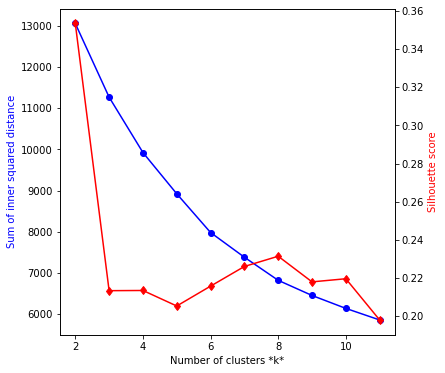

In [129]:
#Evaluate KMeans first to choose K
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score

sse = []
sil = []
list_k = list(range(2, 12))

for k in list_k:
    km = KMeans(n_clusters=k, random_state=0)
    km.fit(candidates_std)
    sse.append(km.inertia_)
    sil.append(silhouette_score(candidates_std, km.labels_))

fig, ax1 = plt.subplots(figsize=(6, 6))

ax2 = ax1.twinx()
ax1.plot(list_k, sse, 'bo-')
ax2.plot(list_k, sil, 'rd-')

ax1.set_xlabel(r'Number of clusters *k*')
ax1.set_ylabel('Sum of inner squared distance', color='b')
ax2.set_ylabel('Silhouette score', color='r')

plt.show()

From the graph above, we can see that the Sum of Squared Distance (SSD) starts at a high value (13000) at K=2 and gradually decreases as K approaches 10. The case for the Silhouette score is different, at K=2 the score starts off high (0.36) but drastically decreases to (0.21) at K=3. It then eventually peaks at K=8 with a score of aprroximately 0.24.

We want to choose the **lowest** sum of squared distance and the **highest** silhouette score. We will choose K=8 because it reflects a balanced number for both values.

In [130]:
#Run K-Means clustering with optimal K
number_of_clusters = 8
kmeans = KMeans(n_clusters=number_of_clusters, random_state=0).fit(candidates_std)
# Show cluster for some cells
kmeans.labels_.tolist()[100:120]

[3, 3, 3, 3, 3, 3, 0, 0, 3, 7, 3, 3, 0, 0, 6, 6, 7, 2, 2, 2]

In [131]:
# Create cluster column in dataframe
df_candidates['Cluster'] = kmeans.labels_
df_candidates.head()

,Address,Latitude,Longitude,X,Y,Distance from central,Population,Density,Average Age,Average Income,Boundary,Shops in cell,Shops within 1km,Shops within 3km,Malls in cell,Malls within 1km,Malls within 3km,Cluster
0,"Rose Cottage, Carshalton Rd, Banstead SM7 3JA",51.332255,-0.171414,-554116.768333,5.796889e+06,20048.954645,201751.000000,46.100000,38.700000,49170.000000,POLYGON ((-0.1731077768216882 51.3372650908228...,0,0,0,0,0,0,3
1,"73 Lower Pillory Down, Little Woodcote, Little...",51.334091,-0.157560,-553116.768333,5.796889e+06,19717.417166,201751.000000,46.100000,38.700000,49170.000000,POLYGON ((-0.1592524766646062 51.3391020815949...,0,0,3,0,0,1,3
2,"6 Verulam Ave, Purley CR8 3NQ",51.335926,-0.143705,-552116.768333,5.796889e+06,19431.739424,328743.068175,44.911571,37.441663,46338.741771,POLYGON ((-0.1453957140742455 51.3409374797409...,0,0,3,0,0,2,2
3,"2 Silver Ln, Purley CR8 3HG",51.337760,-0.129848,-551116.768333,5.796889e+06,19193.969219,383408.000000,44.400000,36.900000,45120.000000,POLYGON ((-0.1315374901154749 51.3427712848559...,0,0,3,0,0,3,2
4,"926 Brighton Rd, Purley CR8 2LN",51.339592,-0.115990,-550116.768333,5.796889e+06,19005.904655,383408.000000,44.400000,36.900000,45120.000000,POLYGON ((-0.117677805853971 51.34460349653485...,0,0,0,1,0,1,2


In [132]:
def category_style(feature):
    c = feature['geometry']['label']
    return { 'color': c, 'fillColor': c, 'fillOpacity': 0.4 }

In [136]:
from shapely.geometry import mapping

colormap = ['lightgreen', 'green', 'darkblue', 'orange', 'darkred',
             'purple', 'darkgreen', 'lightblue', 'cadetblue', 'red']

center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.Marker(london_center, popup='Central London').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
for hexagon, label in zip(df_candidates['Boundary'], df_candidates['Cluster']):
    shape = mapping(hexagon.convex_hull)
    shape['label'] = f'{colormap[label]}'
    folium.GeoJson(shape, style_function=category_style).add_to(map_london)
map_london

* Above we can see the final result of clustering each area of London. Boroughs located in the suburbs tend to be similar to their neighbours and this can be seen if we look at the boroughs in yellow and dark blue. These areas contain the least clothing stores and shopping malls and also have a lower average income. 
* Moving onto the dark green cluster, this group of cells represent areas that have a moderate amount of clothing stores and shopping malls. 
* The clusters in red and purple represent the best possible areas to open a store. In particular, the red cluster containing 3 hexagon cells is the best possible area to open a store as there are an abundance of clothing stores and shopping malls and the population density and average income is very high. This is very promising for stakeholders looking for an area that returns the highest profits.
* We will visualize all attributes on one map. These include shopping malls, marked as a blue point, and shops marked with a red point.

In [137]:
def transparent_style(feature):
    c = feature['geometry']['label']
    return { 'color': c, 'fillColor': c, 'fillOpacity': 0.3 }

center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
Shop_latlon = [(res[2], res[3]) for res in london_shops.values()]

map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.Marker(london_center, popup='Central London').add_to(map_london)
folium.TileLayer('cartodbpositron').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
for hexagon, label in zip(df_candidates['Boundary'], df_candidates['Cluster']):
    shape = mapping(hexagon.convex_hull)
    shape['label'] = f'{colormap[label]}'
    folium.GeoJson(shape, style_function=transparent_style).add_to(map_london)
for res in london_malls.values():
    lat = res[2]; lon = res[3]
    color = 'blue'
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_london)
for res in london_shops.values():
    lat = res[2]; lon = res[3]
    folium.CircleMarker([lat, lon], radius=3, color='yellow', weight=1, fill=True, fill_color='red', fill_opacity=1).add_to(map_london)

map_london

From the map above including all of the clusters. We can see that there is a single cluster coloured in purple in central london. And there is a smaller cluster consisting of 3 hexagons in red, which is right in the center of the city. There are many clothing stores and shopping malls within both of these clusters, with the higher concentration of both within the red cluster.

As we move towards the outer areas of london, inevitably the amount of clothing stores and malls decrease. This is reflected by the green, blue and orange clusters which consist of many hexagons. This shows that these areas are mostly the same in nature.

We will now combine all features related to clothing stores into one, and the same process for shopping malls aswell. This allows us to more easily sort attributes. The clothing store score and shopping mall score will both be weighted, and then we will generate a final score which consists of both scores within one.

The higher the score, the larger amount of clothing stores and shopping malls within the area.


In [143]:
#Calculate weighted Mall Score
df_candidates['Mall Score'] = df_candidates['Malls in cell']*5 + df_candidates['Malls within 1km']*3 + df_candidates['Malls within 3km']

#Calculate weighted shop Score
df_candidates['Shop Score'] = df_candidates['Shops in cell']*5 + df_candidates['Shops within 1km']*3 + df_candidates['Shops within 3km']

#Calculate Score based on Shop Score and Mall Score
df_candidates['Score'] = df_candidates['Shop Score'] - df_candidates['Mall Score']

In [144]:
#Group the dataset by cluster and sort by Score in descending order
result = df_candidates.drop(columns=['Address', 'Latitude', 'Longitude', 'X', 'Y']).groupby(['Cluster'])['Population', 'Density', 'Average Age', 'Average Income', 'Distance from central', 'Malls in cell', 'Malls within 1km', 'Malls within 3km', 'Shops in cell', 'Shops within 1km', 'Shops within 3km', 'Mall Score', 'Shop Score', 'Score'].mean().sort_values(by='Score', ascending=False)

result

,Population,Density,Average Age,Average Income,Distance from central,Malls in cell,Malls within 1km,Malls within 3km,Shops in cell,Shops within 1km,Shops within 3km,Mall Score,Shop Score,Score
Cluster,,,,,,,,,,,,,,
4,239905.668501,110.364255,37.516595,79999.226792,917.894687,3.666667,7.000000,14.333333,10.000000,18.666667,15.000000,53.666667,121.000000,67.333333
7,280924.065139,73.215516,36.067935,51153.733308,12025.755465,2.535714,0.714286,3.892857,4.821429,1.321429,5.392857,18.714286,33.464286,14.750000
6,293783.432433,65.833071,36.190538,50194.282714,13176.414471,0.294118,2.901961,2.921569,0.450980,5.764706,4.549020,13.098039,24.098039,11.000000
5,207824.025824,112.869691,37.323963,80442.703830,3209.241863,0.541667,1.562500,18.625000,0.395833,1.750000,28.291667,26.020833,35.520833,9.500000
0,203956.511711,57.049161,37.348280,65556.229921,13400.482483,0.020101,0.120603,2.809045,0.075377,0.311558,6.356784,3.271357,7.668342,4.396985
1,302211.166270,100.914130,34.105389,46286.704085,9032.289359,0.121107,0.384083,7.000000,0.159170,0.536332,9.937716,8.757785,12.342561,3.584775
3,267222.139313,30.597509,39.548482,48272.560882,20896.037138,0.031579,0.094737,1.623684,0.063158,0.152632,3.592105,2.065789,4.365789,2.300000
2,308998.590938,50.955520,35.854950,44636.905254,16313.188472,0.051839,0.122074,2.239130,0.068562,0.178930,3.707358,2.864548,4.586957,1.722408


* As shown above, Cluster 4 has the highest score of 67.3, meaning it has the most shopping malls and clothing stores within the area.
* The second highest scoring cluster has a value of 14.7, significantly lower than the highest scoring one. 

Lets have a closer look at this cluster.

In [145]:
df_candidates[df_candidates['Cluster']==4].drop(columns=['Address', 'Latitude', 'Longitude', 'X', 'Y']).describe()

,Distance from central,Population,Density,Average Age,Average Income,Shops in cell,Shops within 1km,Shops within 3km,Malls in cell,Malls within 1km,Malls within 3km,Cluster,Mall Score,Shop Score,Score
count,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.0,3.000000,3.0,3.000000,3.000000,3.000000
mean,917.894687,239905.668501,110.364255,37.516595,79999.226792,10.000000,18.666667,15.000000,3.666667,7.0,14.333333,4.0,53.666667,121.000000,67.333333
std,530.559682,44.548550,0.036465,0.085086,776.105034,2.645751,2.516611,3.605551,1.527525,2.0,2.081666,0.0,6.110101,11.532563,15.947832
min,313.659591,239862.000000,110.327110,37.429922,79208.648625,8.000000,16.000000,12.000000,2.000000,5.0,12.000000,4.0,47.000000,109.000000,54.000000
25%,723.050820,239882.978846,110.346382,37.474892,79618.840188,8.500000,17.500000,13.000000,3.000000,6.0,13.500000,4.0,51.000000,115.500000,58.500000
50%,1132.442050,239903.957692,110.365655,37.519863,80029.031750,9.000000,19.000000,14.000000,4.000000,7.0,15.000000,4.0,55.000000,122.000000,63.000000
75%,1220.012235,239927.502752,110.382828,37.559931,80394.515875,11.000000,20.000000,16.500000,4.500000,8.0,15.500000,4.0,57.000000,127.000000,74.000000
max,1307.582420,239951.047812,110.400000,37.600000,80760.000000,13.000000,21.000000,19.000000,5.000000,9.0,16.000000,4.0,59.000000,132.000000,85.000000


Shown in the table above, we can see that there are 3 hexagons within Cluster 4. 
* There is an average of 10 clothing stores within each cell whilst there is an average of 3.6 shopping malls. 
* There is an average of 18.6 clothing stores within 1km of the centre of the cell, whilst there is an average 14.3 malls. 


We will plot every cluster so we can compare each feature to one another. We will use Cluster 4 as our target cluster.

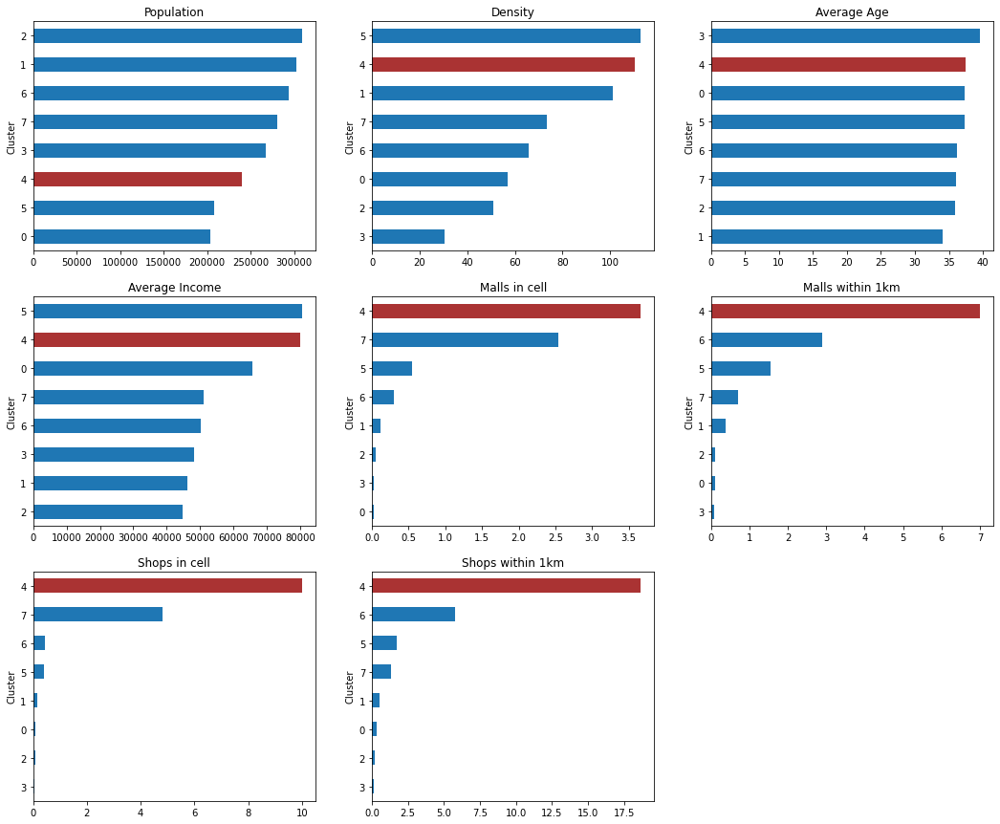

In [146]:
import matplotlib.pyplot as plt

def draw_barchart(dataframe, highlight_index):
    fig = plt.figure(figsize=(18, 15))
    n_rows = n_cols = math.ceil(math.sqrt(dataframe.columns.size))
    for i, col in enumerate(dataframe.columns):
        df = dataframe[[col]].sort_values(by=col)
        ax = fig.add_subplot(n_rows, n_cols, i+1)
        df.plot.barh(ax=ax)
        pos = df.index.get_loc(highlight_index)
        ax.patches[pos].set_facecolor('#aa3333')
        ax.set_title(col)
        ax.get_legend().remove()
    # fig.tight_layout()
    plt.show()

draw_barchart(result[['Population', 'Density', 'Average Age', 'Average Income',
                      'Malls in cell', 'Malls within 1km', 'Shops in cell', 'Shops within 1km']], 4)

* From the bar charts above, we can see that Cluster 4 has one of the lowest population counts, however it has one of the highest density counts.
* We can also see that Cluster 4 has the second highest average income, which is very promising for stakeholders who want to open a clothing store in that area.
* Lastly, we can see that there is a large number of shops and malls within cluster 4, compared to other cells.


Normally, we would pick the first 5 hexagons within the cluster to recommend opening a clothing store. However as the cluster only contains 3 hexagon cells, we can recommend all three of them as they will all reflect the most promising area to open a store.

We will still list these hexagons in descending order just to see which cells are the most promising.

In [149]:
selection_df = df_candidates[df_candidates['Cluster'] == 4].sort_values(['Score'], ascending=[False]).head()
selection_df[['Population', 'Density', 'Average Age', 'Average Income',
                      'Malls in cell', 'Malls within 1km', 'Shops in cell', 'Shops within 1km', 'Mall Score', 'Shop Score', 'Score']]

,Population,Density,Average Age,Average Income,Malls in cell,Malls within 1km,Shops in cell,Shops within 1km,Mall Score,Shop Score,Score
914,239951.047812,110.327110,37.429922,79208.648625,2,7,13,16,47,132,85
857,239903.957692,110.365655,37.519863,80029.031750,4,9,9,21,59,122,63
856,239862.000000,110.400000,37.600000,80760.000000,5,5,8,19,55,109,54


In [151]:
# Plot the target cluster and highlight the choices
center = xy_to_lonlat((ldn_max_x+ldn_min_x)/2, (ldn_max_y+ldn_min_y)/2)
map_london = folium.Map(location=(center[1], center[0]), zoom_start=11)
folium.Marker(london_center, popup='Central London').add_to(map_london)
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
HeatMap(cinema_latlon).add_to(map_london)

for hexagon, label in zip(df_candidates['Boundary'], df_candidates['Cluster']):
    shape = mapping(hexagon.convex_hull)
    if label == 4:
        shape['label'] = colormap[label]
    else:
        shape['label'] = 'gray'
    folium.GeoJson(shape, style_function=transparent_style).add_to(map_london)
for area in selection_df['Boundary']:
    shape = mapping(area.convex_hull)
    shape['label'] = 'red'
    folium.GeoJson(shape, style_function=transparent_style).add_to(map_london)
for res in london_malls.values():
    lat = res[2]; lon = res[3]
    color = 'blue'
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_london)
map_london

Our Analysis has now finished. We have used K-means to segment and cluster the neighbourhoods of London to find the most promising areas open a clothing store. These areas contain the highest concentration of clothing stores and shopping mall, which satisfy the criteria we defined at the start of the project.

Each neighbourhood and borough are represented using a hexagon shape in a grid format, this is a popular method of viewing maps. The areas in the cluster highlighted in the middle also contain the highest average income, population and population density.

# Results and Evaluation

After segmenting and clustering every single neighbourhood within London, we were able to accurately determine which areas are the most promising to open a clothing store.

We generated a hexagon cell grid that covers approximately 95% of the land area in London. We then grouped these hexagon cells into 8 clusters based upon features such as income, density, population, and age. We also considered existing clothing stores and shopping malls in our analysis to ultimately decide which area provides the most value to the primary stakeholder. From the analysis carried out, we can see that clothing stores are mostly located near shopping malls. Thus, we wanted to find the area which has a large number of both clothing stores and shopping malls.

The process of choosing how many clusters we needed was through statistical testing. In this project we used the sum of squared difference and sihouette score to determine how many clusters would produce the most accurate results. In the end we chose K=8 clusters. After determing the optimal amount of K neighbours to use, we clustered every hexagon cell within London. We found a hexagon cluster consisting of 3 cells which was the most promising cluster of all 8. Located right by the center of London (Trafalgar Square), this cluster contains the highest concentration of clothing stores and shopping mall. Additionally, the census data in this cluster is very promising. The cluster has the highest population density and second highest average income. A very high population density indicates that there are a lot of people walking around the area, and most likely visiting different shops. A high average income is also beneficial because consumers are more likely to have a higher disposable income, which can be spent on clothing. This leads to more sales and ultimately higher profits, a vital factor for owners looking for ideal places to open a business.

The chosen cluster only contains 3 hexagon cells, therefore we can recommend all areas within this cluster, as they all represent the optimal location to open a clothing store. These recommended areas are a good starting point for further analysis and adding more features. There are a number of factors which could impact which area is optimal to open a store. for example, revenue for all clothing stores, rent/real estate prices, crime and traffic could all have an influence on which area is the best. Computing with more features and data, ultimately, will lead to more accurate results and higher confidence that the answer is correct.

# Conclusion

The goal of this project was to find the best area to open a clothing store in London. There were several important objectives we defined to achieve this goal. First we divived London into hexagon cells in a honeycomb grid format. Ultimately, this enabled us to uniquely identify promising areas with high accuracy. Secondly, we used the Foursquare API to fetch clothing store and shopping centre venue data. Additionally, we obtained census data from the London Datastore to gain a further understanding of the city and the people living in it. Thirdly, we grouped similar areas together by using the K-means clustering algorithm. We determined the 3 most promising areas which represent a mixture of factors such as high average income, population density and most importantly, a lot of clothing stores nearby. 

All in all, we were able to achieve the goal we set out at the beginning. Although we collected enough and analyzed data to answer the question, adding more features to the model would allow stakeholders to gain a more sophisticated understanding of London. For example, if we added a feature dedicated to commercial real estate/rent prices, we could advise stakeholders different areas based upon their budget. That said, whilst we could collect more data, it would not have a significant impact upon the analysis and the predictions made.

Now equipped with insights and factual data, stakeholders can now ultimately decide and explore which area they think has the most potential. Ultimately, they have to make a decision and our job was to help inform that decision with analytics. Their decision, however, could be impacted by other factors that we have have not covered in this analysis. For example, revenue for existing clothing stores, rent prices and traffic could all impact the stakeholder's final decision.

# References

* Open a Movie Theater in Montreal (accessed at: https://towardsdatascience.com/the-battle-of-the-neighborhoods-open-a-movie-theater-in-montreal-355cf5c679b8)
* Census Data for London (accessed at: https://data.london.gov.uk/census/)
* London boundaries data (accessed at: https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london)
* Foursquare Places API Documentation (accessed at: https://developer.foursquare.com/docs/places-api/)